In [1]:
#Import relevant data wrangling libraries
import geopandas as gpd #to read geospatial data stored in the shx files and convert to a dataframe
import pandas as pd  #to work with csv files and convert to a dataframe
from pathlib import Path #to work with the file path in Windows or other operating system environment

#Import relevant data visualization libraries
import hvplot.pandas #to build interactive visualizations
import geoviews as gv #to build geocentric interactive visualizations
import geoviews.feature as gf #to configure specific features of geocentric visualizations
from geoviews import opts #to use available options for geocentric visualizations
from cartopy import crs as ccrs, feature as cfeature #to utilize standard cartographic projection overlays and specific features

#to generate visualizations in a Jupyter or Jupyter-like environment
%matplotlib inline 


In [2]:

#load data sources used in the analysis. Please see the READ.MD for specific details regarding sources for each data set, synopis of the data analysis, and data analysis results/conclusions
#1 Shape file which includes polygonal geometry coordinates for US metro/non-metro areas organized by CBSA (Core Based Statistical Area)
df_geo = gpd.read_file(Path("./shape_files/cb_2020_us_cbsa_500k.shx"))
#2 "Mortgage performance trends" (based on Mortgage payments days late delinquency rates) by month from January 2008 to March 2021 organized by CBSA and seperated by 30-89 days and 90 or more days
df_mortgage_delin_over90 = pd.read_csv(Path("MetroAreaMortgagesPercent-90-plusDaysLate-thru-2021-03.csv"))
df_mortgage_delin_30to89 = pd.read_csv(Path("MetroAreaMortgagesPercent-30-89DaysLate-thru-2021-03.csv"))

#After reading in the "Mortgage performance trends" data make a common index so that both data sets can be combined
df_mortgage_delin_over90.set_index(["RegionType","Name","CBSACode"], inplace=True)
df_mortgage_delin_30to89.set_index(["RegionType","Name","CBSACode"], inplace=True)

#Utilizing the common index, both data sets are added together to create "Mortgage performance trends" for 30 days or more to simplify the analysis and focus on the population
#as days late instead of keeping the data segmented by multiple time buckets
df_mortgage_delin_30_over = df_mortgage_delin_over90.add(df_mortgage_delin_30to89)

#After combining the "Mortgage Perfomance trends" into a single data set, the index is reset so that the polygonal geometry coordinate can be added to form a common dataframe
df_mortgage_delin_30_over.reset_index(inplace=True)

#Data is merged and joined along the CBSA field from both data sets. Because the "Mortgage performance trends" data represents mainly metro areas with a population of 500K or more, there is
#substantially less CBSA codes compared to the polygonal geometry coordinates which includes non-metro areas as well. By using an inner join we only merge the data that share the
#same CBSA codes
df_mortgage_delin_30_over_with_geo = df_mortgage_delin_30_over.merge(df_geo,how="inner",left_on="CBSACode",right_on="CBSAFP",)

#Output each of the created dataframes from the above code
display(df_geo.head())
display(df_mortgage_delin_over90.head())
display(df_mortgage_delin_30to89.head())
display(df_mortgage_delin_30_over.head())

#Convert the final combined data to a GeoDataFrame in order to use the Geoframe and Geoviews libraries for data visualizations
df_mortgage_delin_30_over_with_geo = gpd.GeoDataFrame(df_mortgage_delin_30_over_with_geo)

#Create additional data columns that will be utilized in the analysis section. Given the sheer number of data points, 
#reviewing trends as an average for each year would smooth out the data making large outliers in the data less important or relevant to the analysis
df_mortgage_delin_30_over_with_geo["2008_Avg"] = df_mortgage_delin_30_over_with_geo.filter(like="2008").mean(axis=1)
df_mortgage_delin_30_over_with_geo["2009_Avg"] = df_mortgage_delin_30_over_with_geo.filter(like="2009").mean(axis=1)
df_mortgage_delin_30_over_with_geo["2010_Avg"] = df_mortgage_delin_30_over_with_geo.filter(like="2010").mean(axis=1)
df_mortgage_delin_30_over_with_geo["2011_Avg"] = df_mortgage_delin_30_over_with_geo.filter(like="2011").mean(axis=1)
df_mortgage_delin_30_over_with_geo["2012_Avg"] = df_mortgage_delin_30_over_with_geo.filter(like="2012").mean(axis=1)
df_mortgage_delin_30_over_with_geo["2013_Avg"] = df_mortgage_delin_30_over_with_geo.filter(like="2013").mean(axis=1)
df_mortgage_delin_30_over_with_geo["2014_Avg"] = df_mortgage_delin_30_over_with_geo.filter(like="2014").mean(axis=1)
df_mortgage_delin_30_over_with_geo["2015_Avg"] = df_mortgage_delin_30_over_with_geo.filter(like="2015").mean(axis=1)
df_mortgage_delin_30_over_with_geo["2016_Avg"] = df_mortgage_delin_30_over_with_geo.filter(like="2016").mean(axis=1)
df_mortgage_delin_30_over_with_geo["2017_Avg"] = df_mortgage_delin_30_over_with_geo.filter(like="2017").mean(axis=1)
df_mortgage_delin_30_over_with_geo["2018_Avg"] = df_mortgage_delin_30_over_with_geo.filter(like="2018").mean(axis=1)
df_mortgage_delin_30_over_with_geo["2019_Avg"] = df_mortgage_delin_30_over_with_geo.filter(like="2019").mean(axis=1)
df_mortgage_delin_30_over_with_geo["2020_Avg"] = df_mortgage_delin_30_over_with_geo.filter(like="2020").mean(axis=1)
df_mortgage_delin_30_over_with_geo["2021_Avg"] = df_mortgage_delin_30_over_with_geo.filter(like="2021").mean(axis=1)

#Review final output on screen and in an Excel file saved to the local drive
display(df_mortgage_delin_30_over.head())
df_mortgage_delin_30_over_with_geo.to_excel("df_mortgage_delin_30_over_with_geo.xlsx")

,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,NAMELSAD,LSAD,ALAND,AWATER,geometry
0,None,11380,310M600US11380,11380,"Andrews, TX","Andrews, TX Micro Area",M2,3886850259,957039,"POLYGON ((-103.06470 32.52219, -103.00047 32.5..."
1,192,35140,310M600US35140,35140,"Newberry, SC","Newberry, SC Micro Area",M2,1632452022,44011454,"POLYGON ((-81.94372 34.20605, -81.94196 34.208..."
2,None,37540,310M600US37540,37540,"Paris, TN","Paris, TN Micro Area",M2,1455320362,81582236,"POLYGON ((-88.52940 36.17018, -88.52636 36.229..."
3,246,29900,310M600US29900,29900,"Laurinburg, NC","Laurinburg, NC Micro Area",M2,826569986,3842049,"POLYGON ((-79.69251 34.80685, -79.68822 34.809..."
4,315,35460,310M600US35460,35460,"Newport, TN","Newport, TN Micro Area",M2,1129584563,17932684,"POLYGON ((-83.31519 35.89332, -83.31078 35.895..."


2008-01  2008-02  \
RegionType Name                              CBSACode                     
National   United States                     -----         1.5      1.6   
MetroArea  Akron, OH                         10420         1.8      1.9   
           Albany-Schenectady-Troy, NY       10580         1.0      1.1   
           Albuquerque, NM                   10740         1.2      1.1   
           Allentown-Bethlehem-Easton, PA-NJ 10900         1.3      1.2   

                                                       2008-03  2008-04  \
RegionType Name                              CBSACode                     
National   United States                     -----         1.6      1.5   
MetroArea  Akron, OH                         10420         1.8      1.6   
           Albany-Schenectady-Troy, NY       10580         1.0      1.0   
           Albuquerque, NM                   10740         1.1      1.1   
           Allentown-Bethlehem-Easton, PA-NJ 10900         1.2      1.2   

                                                       2008-05  2008-06  \
RegionType Name                              CBSACode                     
National   United States                     -----         1.6      1.7   
MetroArea  Akron, OH                         10420         1.7      1.7   
           Albany-Schenectady-Troy, NY       10580         1.1      1.0   
           Albuquerque, NM                   10740         1.3      1.3   
           Allentown-Bethlehem-Easton, PA-NJ 10900         1.3      1.4   

                                                       2008-07  2008-08  \
RegionType Name                              CBSACode                     
National   United States                     -----         1.9      1.9   
MetroArea  Akron, OH                         10420         1.7      2.0   
           Albany-Schenectady-Troy, NY       10580         1.2      1.1   
           Albuquerque, NM                   10740         1.3      1.4   
           Allentown-Bethlehem-Easton, PA-NJ 10900         1.4      1.4   

                                                       2008-09  2008-10  ...  \
RegionType Name                              CBSACode                    ...   
National   United States                     -----         2.0      2.3  ...   
MetroArea  Akron, OH                         10420         2.0      1.8  ...   
           Albany-Schenectady-Troy, NY       10580         1.4      1.5  ...   
           Albuquerque, NM                   10740         1.5      1.6  ...   
           Allentown-Bethlehem-Easton, PA-NJ 10900         1.5      1.8  ...   

                                                       2020-06  2020-07  \
RegionType Name                              CBSACode                     
National   United States                     -----         0.6      0.6   
MetroArea  Akron, OH                         10420         0.9      0.9   
           Albany-Schenectady-Troy, NY       10580         1.1      1.1   
           Albuquerque, NM                   10740         0.6      0.6   
           Allentown-Bethlehem-Easton, PA-NJ 10900         0.9      0.9   

                                                       2020-08  2020-09  \
RegionType Name                              CBSACode                     
National   United States                     -----         0.6      0.6   
MetroArea  Akron, OH                         10420         0.9      0.8   
           Albany-Schenectady-Troy, NY       10580         1.1      1.1   
           Albuquerque, NM                   10740         0.7      0.7   
           Allentown-Bethlehem-Easton, PA-NJ 10900         0.9      0.8   

                                                       2020-10  2020-11  \
RegionType Name                              CBSACode                     
National   United States                     -----         0.6      0.6   
MetroArea  Akron, OH                         10420         0.8      0.8   
           Albany-Schenectady-Troy, NY

2008-01  2008-02  \
RegionType Name                              CBSACode                     
National   United States                     -----         3.5      3.2   
MetroArea  Akron, OH                         10420         3.4      2.8   
           Albany-Schenectady-Troy, NY       10580         3.0      2.5   
           Albuquerque, NM                   10740         3.0      2.8   
           Allentown-Bethlehem-Easton, PA-NJ 10900         3.5      3.1   

                                                       2008-03  2008-04  \
RegionType Name                              CBSACode                     
National   United States                     -----         3.1      3.1   
MetroArea  Akron, OH                         10420         2.5      2.9   
           Albany-Schenectady-Troy, NY       10580         2.3      2.5   
           Albuquerque, NM                   10740         2.7      2.6   
           Allentown-Bethlehem-Easton, PA-NJ 10900         3.0      2.7   

                                                       2008-05  2008-06  \
RegionType Name                              CBSACode                     
National   United States                     -----         3.2      3.2   
MetroArea  Akron, OH                         10420         2.9      3.2   
           Albany-Schenectady-Troy, NY       10580         2.5      2.8   
           Albuquerque, NM                   10740         2.6      2.9   
           Allentown-Bethlehem-Easton, PA-NJ 10900         3.0      2.8   

                                                       2008-07  2008-08  \
RegionType Name                              CBSACode                     
National   United States                     -----         3.4      3.6   
MetroArea  Akron, OH                         10420         2.9      3.0   
           Albany-Schenectady-Troy, NY       10580         2.7      3.1   
           Albuquerque, NM                   10740         3.0      3.3   
           Allentown-Bethlehem-Easton, PA-NJ 10900         3.1      3.3   

                                                       2008-09  2008-10  ...  \
RegionType Name                              CBSACode                    ...   
National   United States                     -----         3.6      3.8  ...   
MetroArea  Akron, OH                         10420         3.4      3.5  ...   
           Albany-Schenectady-Troy, NY       10580         2.9      3.0  ...   
           Albuquerque, NM                   10740         3.1      3.4  ...   
           Allentown-Bethlehem-Easton, PA-NJ 10900         3.4      3.5  ...   

                                                       2020-06  2020-07  \
RegionType Name                              CBSACode                     
National   United States                     -----         0.8      0.9   
MetroArea  Akron, OH                         10420         0.9      0.9   
           Albany-Schenectady-Troy, NY       10580         0.7      0.9   
           Albuquerque, NM                   10740         1.0      1.1   
           Allentown-Bethlehem-Easton, PA-NJ 10900         1.1      1.1   

                                                       2020-08  2020-09  \
RegionType Name                              CBSACode                     
National   United States                     -----         1.0      0.8   
MetroArea  Akron, OH                         10420         1.1      0.9   
           Albany-Schenectady-Troy, NY       10580         1.0      0.7   
           Albuquerque, NM                   10740         1.0      0.9   
           Allentown-Bethlehem-Easton, PA-NJ 10900         1.1      0.9   

                                                       2020-10  2020-11  \
RegionType Name                              CBSACode                     
National   United States                     -----         1.0      0.8   
MetroArea  Akron, OH                         10420         0.9      1.0   
           Albany-Schenectady-Troy, NY

,RegionType,Name,CBSACode,2008-01,2008-02,2008-03,2008-04,2008-05,2008-06,2008-07,...,2020-06,2020-07,2020-08,2020-09,2020-10,2020-11,2020-12,2021-01,2021-02,2021-03
0,National,United States,-----,5.0,4.8,4.7,4.6,4.8,4.9,5.3,...,1.4,1.5,1.6,1.4,1.6,1.4,1.6,1.6,1.2,1.3
1,MetroArea,"Akron, OH",10420,5.2,4.7,4.3,4.5,4.6,4.9,4.6,...,1.8,1.8,2.0,1.7,1.7,1.8,2.0,1.9,1.6,1.6
2,MetroArea,"Albany-Schenectady-Troy, NY",10580,4.0,3.6,3.3,3.5,3.6,3.8,3.9,...,1.8,2.0,2.1,1.8,1.9,1.7,2.1,2.0,1.4,1.7
3,MetroArea,"Albuquerque, NM",10740,4.2,3.9,3.8,3.7,3.9,4.2,4.3,...,1.6,1.7,1.7,1.6,1.5,1.5,1.8,1.6,1.3,1.2
4,MetroArea,"Allentown-Bethlehem-Easton, PA-NJ",10900,4.8,4.3,4.2,3.9,4.3,4.2,4.5,...,2.0,2.0,2.0,1.7,1.9,1.9,2.0,2.0,1.6,1.7


,RegionType,Name,CBSACode,2008-01,2008-02,2008-03,2008-04,2008-05,2008-06,2008-07,...,2020-06,2020-07,2020-08,2020-09,2020-10,2020-11,2020-12,2021-01,2021-02,2021-03
0,National,United States,-----,5.0,4.8,4.7,4.6,4.8,4.9,5.3,...,1.4,1.5,1.6,1.4,1.6,1.4,1.6,1.6,1.2,1.3
1,MetroArea,"Akron, OH",10420,5.2,4.7,4.3,4.5,4.6,4.9,4.6,...,1.8,1.8,2.0,1.7,1.7,1.8,2.0,1.9,1.6,1.6
2,MetroArea,"Albany-Schenectady-Troy, NY",10580,4.0,3.6,3.3,3.5,3.6,3.8,3.9,...,1.8,2.0,2.1,1.8,1.9,1.7,2.1,2.0,1.4,1.7
3,MetroArea,"Albuquerque, NM",10740,4.2,3.9,3.8,3.7,3.9,4.2,4.3,...,1.6,1.7,1.7,1.6,1.5,1.5,1.8,1.6,1.3,1.2
4,MetroArea,"Allentown-Bethlehem-Easton, PA-NJ",10900,4.8,4.3,4.2,3.9,4.3,4.2,4.5,...,2.0,2.0,2.0,1.7,1.9,1.9,2.0,2.0,1.6,1.7


In [3]:

#Because the data was merged preserving the left dataframe, this check ensures there were no NULL MetroArea's and that each area from the left dataframe joined along 
#the CBSACode and received geometry coordinates
null_geometry_df = df_mortgage_delin_30_over_with_geo[(df_mortgage_delin_30_over_with_geo["RegionType"] == "MetroArea") & (df_mortgage_delin_30_over_with_geo["geometry"] == None)]
print("The Number of NULL values were:",len(null_geometry_df))

The Number of NULL values were: 0


In [4]:
#Visualization showing a colormap for the 2008 average mortgage delinquency rate across 200+ US metro areas
us_poly2008 = gv.Polygons(df_mortgage_delin_30_over_with_geo,vdims=['GEOID','NAME','2008_Avg','2008-01','2008-12'],
label="Mortgage Delinquency rates 30+ Days - 2008 Average").opts(tools=['hover'],color='2008_Avg',cmap="reds",
width=675, height=400, toolbar="above",colorbar=True, projection=ccrs.AlbersEqualArea(central_longitude=-85),infer_projection=True)

set1 = gv.tile_sources.EsriReference * gf.ocean *gf.borders *gf.states *gf.grid * gf.rivers * gf.lakes * gf.coastline*  us_poly2008

display(set1)

:Overlay
   .WMTS.I                                                                     :WMTS   [Longitude,Latitude]
   .Ocean.I                                                                    :Feature   [Longitude,Latitude]
   .Borders.I                                                                  :Feature   [Longitude,Latitude]
   .States.I                                                                   :Feature   [Longitude,Latitude]
   .Grid.I                                                                     :Feature   [Longitude,Latitude]
   .Rivers.I                                                                   :Feature   [Longitude,Latitude]
   .Lakes.I                                                                    :Feature   [Longitude,Latitude]
   .Coastline.I                                                                :Feature   [Longitude,Latitude]
   .Polygons.Mortgage_Delinquency_rates_30_plus_Days_hyphen_minus_2008_Average :Polygons   [Longitude,Latitude]   (GEOID,NAME,2008_Avg,2008-01,2008-12)

In [5]:
#Visualization showing a colormap for the 2020 average mortgage delinquency rate across 200+ US metro areas
us_poly2021 = gv.Polygons(df_mortgage_delin_30_over_with_geo,vdims=['GEOID','NAME','2020_Avg','2020-01','2020-12'],
label="Mortgage Delinquency rates 30+ Days - 2020 Average").opts(tools=['hover'],color='2020_Avg',cmap="reds",
width=675, height=400, toolbar="above",colorbar=True, projection=ccrs.AlbersEqualArea(central_longitude=-85),infer_projection=True)

set2 = gv.tile_sources.EsriReference  * gf.ocean *gf.borders *gf.states *gf.grid * gf.rivers * gf.lakes * gf.coastline * us_poly2021

display(set2)

:Overlay
   .WMTS.I                                                                     :WMTS   [Longitude,Latitude]
   .Ocean.I                                                                    :Feature   [Longitude,Latitude]
   .Borders.I                                                                  :Feature   [Longitude,Latitude]
   .States.I                                                                   :Feature   [Longitude,Latitude]
   .Grid.I                                                                     :Feature   [Longitude,Latitude]
   .Rivers.I                                                                   :Feature   [Longitude,Latitude]
   .Lakes.I                                                                    :Feature   [Longitude,Latitude]
   .Coastline.I                                                                :Feature   [Longitude,Latitude]
   .Polygons.Mortgage_Delinquency_rates_30_plus_Days_hyphen_minus_2020_Average :Polygons   [Longitude,Latitude]   (GEOID,NAME,2020_Avg,2020-01,2020-12)

In [6]:
#Side-by-side visualization showing a colormap for the 2008 average against the 2020 average mortgage delinquency rate across 200+ US metro areas
set1 + set2

:Layout
   .Overlay.Mortgage_Delinquency_rates_30_plus_Days_hyphen_minus_2008_Average :Overlay
      .WMTS.I                                                                     :WMTS   [Longitude,Latitude]
      .Ocean.I                                                                    :Feature   [Longitude,Latitude]
      .Borders.I                                                                  :Feature   [Longitude,Latitude]
      .States.I                                                                   :Feature   [Longitude,Latitude]
      .Grid.I                                                                     :Feature   [Longitude,Latitude]
      .Rivers.I                                                                   :Feature   [Longitude,Latitude]
      .Lakes.I                                                                    :Feature   [Longitude,Latitude]
      .Coastline.I                                                                :Feature   [Longitude,Latitude]
      .Polygons.Mortgage_Delinquency_rates_30_plus_Days_hyphen_minus_2008_Average :Polygons   [Longitude,Latitude]   (GEOID,NAME,2008_Avg,2008-01,2008-12)
   .Overlay.Mortgage_Delinquency_rates_30_plus_Days_hyphen_minus_2020_Average :Overlay
      .WMTS.I                                                                     :WMTS   [Longitude,Latitude]
      .Ocean.I                                                                    :Feature   [Longitude,Latitude]
      .Borders.I                                                                  :Feature   [Longitude,Latitude]
      .States.I                                                                   :Feature   [Longitude,Latitude]
      .Grid.I                                                                     :Feature   [Longitude,Latitude]
      .Rivers.I                                                                   :Feature   [Longitude,Latitude]
      .Lakes.I                                                                    :Feature   [Longitude,Latitude]
      .Coastline.I                                                                :Feature   [Longitude,Latitude]
      .Polygons.Mortgage_Delinquency_rates_30_plus_Days_hyphen_minus_2020_Average :Polygons   [Longitude,Latitude]   (GEOID,NAME,2020_Avg,2020-01,2020-12)

In [7]:

# Data wrangling to create a new dataframe by converting date columns (e.g. 2008-01, 2009-1, etc.) to a single column with data rows
# in order to build interactive trend line charts by using this new single date column as the x-axis 

#Create a list container for dates and metro names to be used in the new dataframe
list_dates = [x for x in df_mortgage_delin_30_over_with_geo.columns if "-" in x or "_" in x]
column_names_metro = list(df_mortgage_delin_30_over_with_geo["NAME"])

#Use iterrows function to convert each date column and corresponding values as it's own list
row_list =[]
for index, rows in df_mortgage_delin_30_over_with_geo.iterrows():
    my_list = rows.filter(like=("20"))
    row_list.append(my_list)

#Transpose, unstack, and restack the dataframe to convert it to the format needed for the linechart interactive visualizations    
new_df = pd.DataFrame(row_list).T
new_df.columns = column_names_metro
df_unstack = new_df.unstack(level=-1)

df_restack = pd.DataFrame(df_unstack)
df_restack.reset_index(level=[0,1],inplace=True)
df_restack.columns = ["Location","Time Period","Delinquency_Percentage"]


In [8]:
# Use hvplot to create an interactive line plot and data table for mortgage delinquency rates by metro area
# The plot has a dropdown selector for each metro area

item1 = df_restack.hvplot.line(x="Time Period",groupby="Location",xlabel="Trending",ylabel="Delinquency Percentage 30+ Days",
title="Mortgage Delinquency rates 30+ Days - Monthly trend 2008-01 to 2021-03",line_width=5,rot=45,line_cap="square",line_dash="dashed")

item2 = df_restack.hvplot.table(columns=["Time Period","Delinquency_Percentage"],groupby="Location",sortable=True,selectable=True)

item1 + item2 

:Layout
   .DynamicMap.I  :DynamicMap   [Location]
      :Curve   [Time Period]   (Delinquency_Percentage)
   .DynamicMap.II :DynamicMap   [Location]
      :Table   [Time Period,Delinquency_Percentage]

In [9]:

#Provides the range of average rates to visualize the range across all 200+ metro areas
df_restack.loc[df_restack["Time Period"].str.contains("Avg")].hvplot.scatter(x="Time Period",xlabel="Trending",ylabel="Delinquency Percentage 30+ Days",title="Mortgage Delinquency rates 30+ Days - Annual Average",
line_width=1,rot=45,persist=True,c="Time Period",cmap="Reds_r",width=900,height=500)

:Scatter   [Time Period]   (Delinquency_Percentage)

In [10]:
#Provides the rolling 12-month average rates to visualize the trend across all time periods

rolling_df_mean = new_df.iloc[:159,:].rolling(12).mean().dropna()

display(rolling_df_mean.hvplot.line(legend=False,rot=45,width=2000,height=600,title="Mortgage Delinquency rates (30+ days) 12-month rolling average"))


:NdOverlay   [Variable]
   :Curve   [index]   (value)

In [16]:
#Modify the dataframe to drop the averages so the data can be utilized in box plots
not_options = ["2008_Avg","2009_Avg","2010_Avg","2011_Avg","2012_Avg","2013_Avg","2014_Avg","2015_Avg","2016_Avg","2017_Avg","2018_Avg","2019_Avg","2020_Avg","2021_Avg"]
df_restack_parsed = df_restack[~df_restack["Time Period"].isin(not_options)]

#Split the Time Period column in Year and Month labels so data can be grouped or organized around those labels
df_restack_parsed_cols = df_restack_parsed["Time Period"].str.split("-",expand=True)
df_restack_parsed["Year"] = df_restack_parsed_cols[0]
df_restack_parsed["Month"] = df_restack_parsed_cols[1]

#Boxplot showing the dispersion of monthly delinquency rates across all metros for the entire data set (2008 to March 2021)
display(df_restack_parsed.hvplot.box(y="Delinquency_Percentage",by="Location",legend=False,c="orange",height=600,width=5000,rot=45,
title="Dispersion of Monthly Mortgage Delinquency Rates from 2008 to March, 2021 by Location"))

#Boxplot showing the dispersion by year for a metro area selected in the drop-down menu
boxplot = df_restack_parsed.hvplot.box(y="Delinquency_Percentage",by="Year",legend=False,c="orange",height=400,width=800,rot=45,
groupby="Location",title="Dispersion of Monthly Mortgage Delinquency Rates by Year")

display(boxplot * df_restack_parsed.hvplot.scatter(y="Delinquency_Percentage",x="Year",c="red",groupby="Location").opts(jitter=0.5))

<ipython-input-16-b3c8cf9ff49b>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_restack_parsed["Year"] = df_restack_parsed_cols[0]
<ipython-input-16-b3c8cf9ff49b>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_restack_parsed["Month"] = df_restack_parsed_cols[1]


:BoxWhisker   [Location]   (Delinquency_Percentage)

:DynamicMap   [Location]
   :Overlay
      .BoxWhisker.I :BoxWhisker   [Year]   (Delinquency_Percentage)
      .Scatter.I    :Scatter   [Year]   (Delinquency_Percentage)

In [17]:
#Generate data to be used in the correalation analysis. Average all observations by each month to get an average mortgage delinquency rate (30+ days) across 200+ metros
#to be compared against the MoM change in the average adjust close price of the 14 selected banks

#Get data for the correlation analysis
mortgage_data_df = pd.DataFrame(df_restack_parsed.groupby("Time Period").mean())
stock_data_df = pd.read_excel("monthly_chg_stocks.xlsx")
mortgage_data_df.reset_index(inplace=True)

#build combined dataframe for both data sources
combined_df = mortgage_data_df.merge(stock_data_df,left_index=True,right_index=True)
combined_df = combined_df.drop(columns=["Date"])
new_column_list = ["Time Period", "Mortgage_Delin_Percentage", "Stock_Price_MoM_Adj_Close_Chg"]
combined_df.columns = new_column_list

#Review about of data
display(mortgage_data_df)
display(stock_data_df)
display(combined_df)


,Time Period,Delinquency_Percentage
0,2008-01,4.851852
1,2008-02,4.573704
2,2008-03,4.371852
3,2008-04,4.362963
4,2008-05,4.598889
...,...,...
154,2020-11,1.433333
155,2020-12,1.630370
156,2021-01,1.580370
157,2021-02,1.305185


,Date,0
0,2008-01-31,-0.004221
1,2008-02-29,-0.127807
2,2008-03-31,-0.022558
3,2008-04-30,0.099657
4,2008-05-30,-0.083456
...,...,...
154,2020-11-30,0.211900
155,2020-12-31,0.103199
156,2021-01-29,0.002198
157,2021-02-26,0.150890


,Time Period,Mortgage_Delin_Percentage,Stock_Price_MoM_Adj_Close_Chg
0,2008-01,4.851852,-0.004221
1,2008-02,4.573704,-0.127807
2,2008-03,4.371852,-0.022558
3,2008-04,4.362963,0.099657
4,2008-05,4.598889,-0.083456
...,...,...,...
154,2020-11,1.433333,0.211900
155,2020-12,1.630370,0.103199
156,2021-01,1.580370,0.002198
157,2021-02,1.305185,0.150890


,Mortgage_Delin_Percentage,Stock_Price_MoM_Adj_Close_Chg
Mortgage_Delin_Percentage,1.000000,-0.063862
Stock_Price_MoM_Adj_Close_Chg,-0.063862,1.000000


,Mortgage_Delin_Percentage,Stock_Price_MoM_Adj_Close_Chg
Mortgage_Delin_Percentage,1.000000,-0.037019
Stock_Price_MoM_Adj_Close_Chg,-0.037019,1.000000


,Mortgage_Delin_Percentage,Stock_Price_MoM_Adj_Close_Chg
Mortgage_Delin_Percentage,1.00000,-0.04934
Stock_Price_MoM_Adj_Close_Chg,-0.04934,1.00000


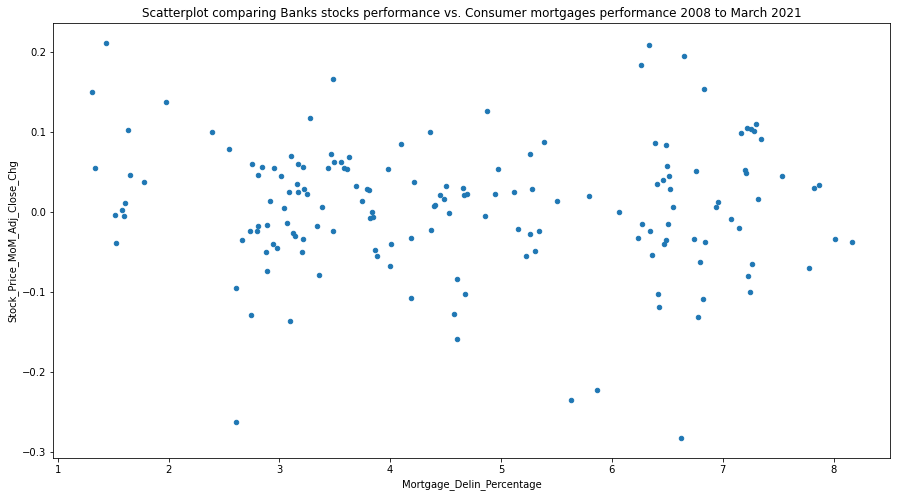

In [18]:
#Final correlation analysis using a scatter lot and calculating a correlation coefficient

combined_df.plot.scatter(x="Mortgage_Delin_Percentage",y="Stock_Price_MoM_Adj_Close_Chg",figsize=(15,8),
title="Scatterplot comparing Banks stocks performance vs. Consumer mortgages performance 2008 to March 2021")

display(combined_df.corr(method="pearson"))

display(combined_df.corr(method="kendall"))

display(combined_df.corr(method="spearman"))

,Mortgage_Delin_Percentage,Stock_Price_MoM_Adj_Close_Chg
Mortgage_Delin_Percentage,1.000000,0.178722
Stock_Price_MoM_Adj_Close_Chg,0.178722,1.000000


,Mortgage_Delin_Percentage,Stock_Price_MoM_Adj_Close_Chg
Mortgage_Delin_Percentage,1.000000,0.092063
Stock_Price_MoM_Adj_Close_Chg,0.092063,1.000000


,Mortgage_Delin_Percentage,Stock_Price_MoM_Adj_Close_Chg
Mortgage_Delin_Percentage,1.00000,0.16834
Stock_Price_MoM_Adj_Close_Chg,0.16834,1.00000


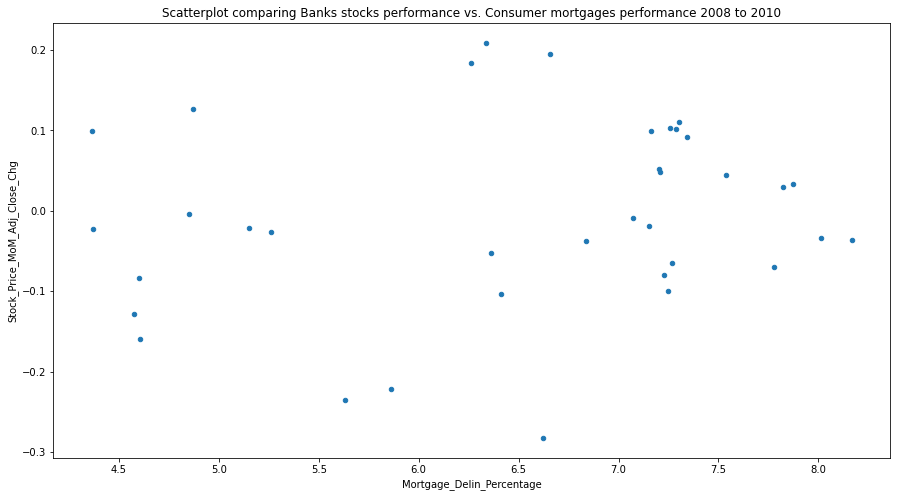

In [19]:
#Final correlation analysis using a scatter lot and calculating a correlation coefficient [2008 to 2010]

combined_df.iloc[0:36,:].plot.scatter(x="Mortgage_Delin_Percentage",y="Stock_Price_MoM_Adj_Close_Chg",figsize=(15,8),
title="Scatterplot comparing Banks stocks performance vs. Consumer mortgages performance 2008 to 2010")

display(combined_df.iloc[0:36,:].corr(method="pearson"))

display(combined_df.iloc[0:36,:].corr(method="kendall"))

display(combined_df.iloc[0:36,:].corr(method="spearman"))

,Mortgage_Delin_Percentage,Stock_Price_MoM_Adj_Close_Chg
Mortgage_Delin_Percentage,1.000000,-0.321196
Stock_Price_MoM_Adj_Close_Chg,-0.321196,1.000000


,Mortgage_Delin_Percentage,Stock_Price_MoM_Adj_Close_Chg
Mortgage_Delin_Percentage,1.000000,-0.147099
Stock_Price_MoM_Adj_Close_Chg,-0.147099,1.000000


,Mortgage_Delin_Percentage,Stock_Price_MoM_Adj_Close_Chg
Mortgage_Delin_Percentage,1.000000,-0.234211
Stock_Price_MoM_Adj_Close_Chg,-0.234211,1.000000


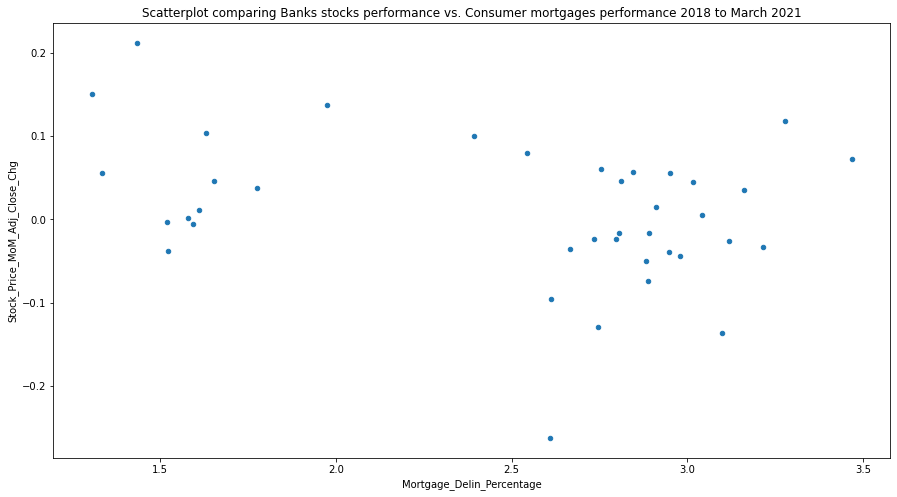

In [20]:
#Final correlation analysis using a scatter lot and calculating a correlation coefficient [2018 to March 2021]

combined_df.iloc[120:,:].plot.scatter(x="Mortgage_Delin_Percentage",y="Stock_Price_MoM_Adj_Close_Chg",figsize=(15,8),
title="Scatterplot comparing Banks stocks performance vs. Consumer mortgages performance 2018 to March 2021")

display(combined_df.iloc[120:,:].corr(method="pearson"))

display(combined_df.iloc[120:,:].corr(method="kendall"))

display(combined_df.iloc[120:,:].corr(method="spearman"))